In [1]:
# imports

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import *
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import cross_val_score
from sklearn import preprocessing
from sklearn.metrics import *
from sklearn.model_selection import train_test_split
import statsmodels.api as sm
import statsmodels.formula.api as smf


In [2]:
#From Qbus3820


import warnings
warnings.filterwarnings('ignore') 

# Plot settings
sns.set_context('notebook') # optimises figures for notebook display
sns.set_style('ticks') # set default plot style
colours = ['#4E79A7','#F28E2C','#E15759','#76B7B2','#59A14F', 
          '#EDC949','#AF7AA1','#FF9DA7','#9C755F','#BAB0AB']
sns.set_palette(colours) # set custom color scheme

%matplotlib inline
plt.rcParams['figure.figsize'] = (9, 6)
plt.rcParams['figure.dpi'] = 80
%config InlineBackend.figure_format = 'retina'


# Read in data

In [3]:
random_state = 1
data = pd.read_csv("credit_data.csv")
data.head()

,Assets_Total,Cash,Debt_in_Current_Liabilities_Total,Long_Term_Debt_Total,Earnings_Before_Interest,Gross_Profit_(Loss),Liabilities_Total,Retained_Earnings,Total_debt/total_asset,total_asset/total_libiilities,...,Employees,Inventories_Total,Earnings_Per_Share_from_Operations,Revenue_Total,Operating_Activities_Net_Cash_Flow,Financing_Activities_Net_Cash_Flow,Net_Cash_Flow,ID,Year,Rating
0,43771.000,994.000,1708.00,16196.000,6585.000,13139.000,41750.000,-13121.000,0.370017,1.048407,...,113.300,1004.000,5.37,42650.000,3080.000,-315.000,2765.000,1,2014,4
1,14313.532,7.604,530.97,3031.215,1228.600,1228.600,9794.430,1857.924,0.211773,1.461395,...,6.366,255.986,3.54,3491.632,1099.627,-178.881,920.746,2,2014,1
2,41275.000,4063.000,4437.00,3408.000,4475.000,12088.000,19636.000,17821.000,0.082568,2.102007,...,77.000,2643.000,1.57,20247.000,3675.000,-2742.000,933.000,3,2014,1
3,2210.772,466.829,0.00,0.000,134.767,308.828,165.461,1759.236,0.000000,13.361288,...,1.635,149.402,2.61,660.235,133.583,-45.802,87.781,4,2014,3
4,53402.100,1420.400,729.30,7852.000,4848.700,15091.500,38850.300,9940.400,0.147035,1.374561,...,48.800,0.000,6.46,58003.200,3372.800,-1235.000,2137.800,5,2014,1


In [4]:
data.describe()

,Assets_Total,Cash,Debt_in_Current_Liabilities_Total,Long_Term_Debt_Total,Earnings_Before_Interest,Gross_Profit_(Loss),Liabilities_Total,Retained_Earnings,Total_debt/total_asset,total_asset/total_libiilities,...,Employees,Inventories_Total,Earnings_Per_Share_from_Operations,Revenue_Total,Operating_Activities_Net_Cash_Flow,Financing_Activities_Net_Cash_Flow,Net_Cash_Flow,ID,Year,Rating
count,2.703000e+03,2694.000000,2703.000000,2703.000000,2703.000000,2703.000000,2.703000e+03,2702.000000,2703.000000,2703.000000,...,2701.00000,2699.000000,2701.000000,2703.000000,2702.000000,2702.000000,2703.000000,2703.000000,2703.000000,2703.000000
mean,2.800096e+04,1323.806837,2141.720158,5531.684198,1995.658005,3480.767147,2.158373e+04,4176.136248,0.533965,2.684546,...,27.50770,2282.520190,5.727083,10454.909050,1681.812082,-335.728155,1345.585383,451.000000,2014.666667,2.559009
std,1.067372e+05,4886.370903,16477.936202,14255.440422,4868.422875,8217.026855,9.518641e+04,18384.320196,9.668311,56.107574,...,164.79961,17861.011789,176.170685,23115.607006,4592.494369,4130.445927,4841.362735,260.144262,0.471492,0.995983
min,1.040270e+02,0.000000,0.000000,0.000000,-21913.000000,-21536.000000,9.883300e+01,-82378.000000,0.000000,0.273500,...,0.00000,0.000000,-55.610000,-982.123000,-16571.000000,-89131.000000,-89375.000000,1.000000,2014.000000,1.000000
25%,2.384939e+03,76.920750,4.810500,741.719000,233.028000,416.483500,1.552443e+03,-148.598750,0.213534,1.261492,...,2.62800,9.216000,0.590000,1363.801000,165.600000,-403.696250,84.230500,226.000000,2014.000000,2.000000
50%,5.734529e+03,268.790500,53.615000,1730.264000,586.400000,1085.600000,3.734468e+03,682.434500,0.319220,1.508613,...,8.00000,204.967000,1.970000,3414.300000,445.000000,-77.586000,319.000000,451.000000,2015.000000,3.000000
75%,1.742934e+04,889.319750,400.487500,4885.163000,1811.350000,2957.145500,1.136110e+04,3108.988750,0.442328,1.815550,...,23.46300,789.652500,3.690000,9480.656500,1366.719250,95.137500,1107.046500,676.000000,2015.000000,3.000000
max,1.842530e+06,121711.000000,307887.000000,245649.000000,81730.000000,104126.000000,1.630485e+06,389427.000000,502.887000,2918.442000,...,8195.04650,341053.000000,9153.460000,364763.000000,81266.000000,33443.400000,82224.000000,901.000000,2015.000000,4.000000


In [5]:
data.corr()["Rating"].abs().sort_values(ascending=False)

Rating                                   1.000000
Market_Value_Total_Fiscal                0.420414
Gross_Profit_(Loss)                      0.379609
Earnings_Before_Interest                 0.366983
Dividends_per_Share_Pay_Date_Calendar    0.366417
Revenue_Total                            0.364932
Sales/Turnover_(Net)                     0.364928
Common_Equity_Liquidation_Value          0.359138
Stockholders_Equity_Total                0.358273
ID                                       0.353981
Operating_Activities_Net_Cash_Flow       0.343837
Retained_Earnings                        0.312384
Comprehensive_Income_Parent              0.297649
Assets_Total                             0.251009
Long_Term_Debt_Total                     0.235142
Cash                                     0.232941
Liabilities_Total                        0.220517
Interest_and_Related_Expense_Total       0.207264
Net_Cash_Flow                            0.206262
EBTI/REV                                 0.163504


<AxesSubplot:title={'center':'Correlation Heatmap'}>

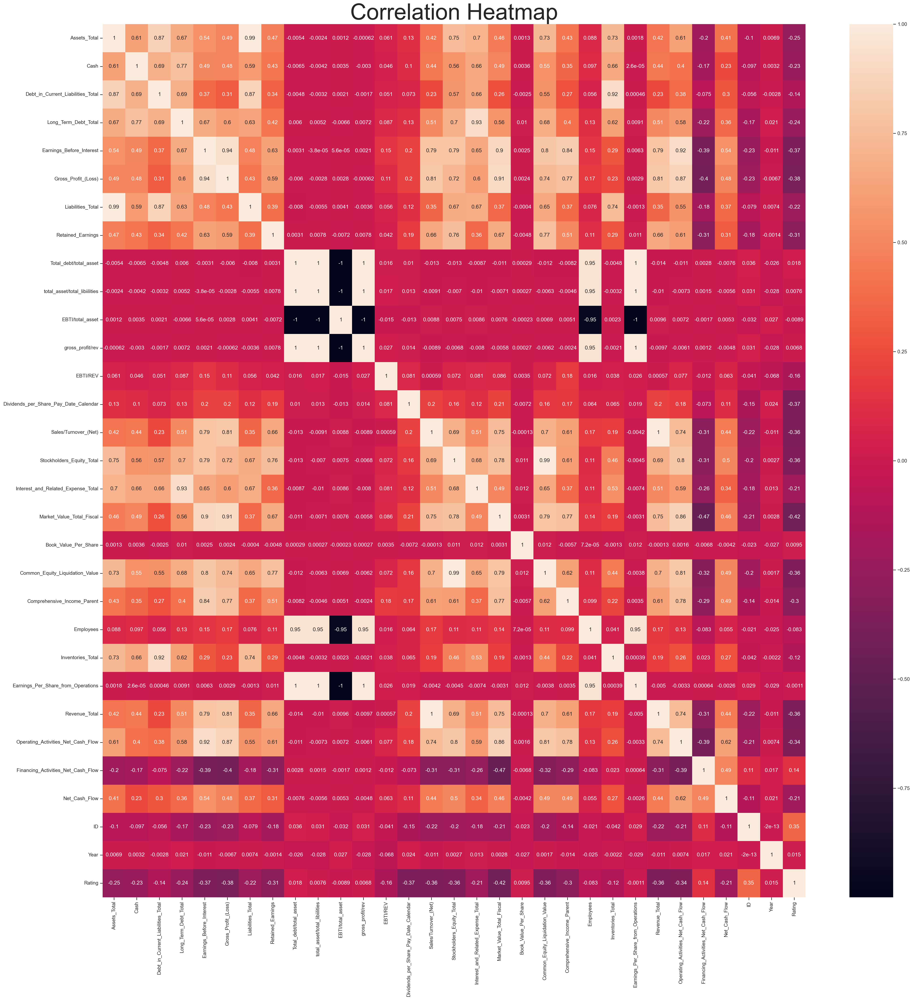

In [6]:
plt.subplots(figsize=(35,35))
plt.title("Correlation Heatmap", fontsize=50)
sns.heatmap(data.corr(), annot=True)


# Data cleaning

In [7]:
from dataprep.eda import plot

In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2703 entries, 0 to 2702
Data columns (total 31 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   Assets_Total                           2703 non-null   float64
 1   Cash                                   2694 non-null   float64
 2   Debt_in_Current_Liabilities_Total      2703 non-null   float64
 3   Long_Term_Debt_Total                   2703 non-null   float64
 4   Earnings_Before_Interest               2703 non-null   float64
 5   Gross_Profit_(Loss)                    2703 non-null   float64
 6   Liabilities_Total                      2703 non-null   float64
 7   Retained_Earnings                      2702 non-null   float64
 8   Total_debt/total_asset                 2703 non-null   float64
 9   total_asset/total_libiilities          2703 non-null   float64
 10  EBTI/total_asset                       2703 non-null   float64
 11  gros

In [9]:
nulls = data.isnull().sum()
nulls

Assets_Total                              0
Cash                                      9
Debt_in_Current_Liabilities_Total         0
Long_Term_Debt_Total                      0
Earnings_Before_Interest                  0
Gross_Profit_(Loss)                       0
Liabilities_Total                         0
Retained_Earnings                         1
Total_debt/total_asset                    0
total_asset/total_libiilities             0
EBTI/total_asset                          0
gross_profit/rev                          0
EBTI/REV                                  0
Dividends_per_Share_Pay_Date_Calendar     4
Sales/Turnover_(Net)                      0
Stockholders_Equity_Total                 0
Interest_and_Related_Expense_Total        1
Market_Value_Total_Fiscal                92
Book_Value_Per_Share                      1
Common_Equity_Liquidation_Value           0
Comprehensive_Income_Parent               1
Employees                                 2
Inventories_Total               

In [10]:
data.columns

Index(['Assets_Total', 'Cash', 'Debt_in_Current_Liabilities_Total',
       'Long_Term_Debt_Total', 'Earnings_Before_Interest',
       'Gross_Profit_(Loss)', 'Liabilities_Total', 'Retained_Earnings',
       'Total_debt/total_asset', 'total_asset/total_libiilities',
       'EBTI/total_asset', 'gross_profit/rev', 'EBTI/REV',
       'Dividends_per_Share_Pay_Date_Calendar', 'Sales/Turnover_(Net)',
       'Stockholders_Equity_Total', 'Interest_and_Related_Expense_Total',
       'Market_Value_Total_Fiscal', 'Book_Value_Per_Share',
       'Common_Equity_Liquidation_Value', 'Comprehensive_Income_Parent',
       'Employees', 'Inventories_Total', 'Earnings_Per_Share_from_Operations',
       'Revenue_Total', 'Operating_Activities_Net_Cash_Flow',
       'Financing_Activities_Net_Cash_Flow', 'Net_Cash_Flow', 'ID', 'Year',
       'Rating'],
      dtype='object')

We will first look at the correlation between each variable, then we will use the other columns to impute the missing values

In [11]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer


In [12]:
nulls = data.isnull().sum()
nulls

Assets_Total                              0
Cash                                      9
Debt_in_Current_Liabilities_Total         0
Long_Term_Debt_Total                      0
Earnings_Before_Interest                  0
Gross_Profit_(Loss)                       0
Liabilities_Total                         0
Retained_Earnings                         1
Total_debt/total_asset                    0
total_asset/total_libiilities             0
EBTI/total_asset                          0
gross_profit/rev                          0
EBTI/REV                                  0
Dividends_per_Share_Pay_Date_Calendar     4
Sales/Turnover_(Net)                      0
Stockholders_Equity_Total                 0
Interest_and_Related_Expense_Total        1
Market_Value_Total_Fiscal                92
Book_Value_Per_Share                      1
Common_Equity_Liquidation_Value           0
Comprehensive_Income_Parent               1
Employees                                 2
Inventories_Total               

In [13]:
# Imputes the missing values for each column using the most correlated 2 other columns to the missing value columnn.

for i in range(len(nulls)):
    if nulls[i] > 0:
        feature_name = data.columns[i]
        most_correlated = data.corr()[feature_name].abs().sort_values(ascending=False).head(3)
        most_correlated = most_correlated.index

        print(feature_name)
        print(most_correlated)
        print()

        predictors = most_correlated
        X_train = data.loc[:,predictors]
        imputer =  IterativeImputer()
        imputer.fit(X_train)
        data[predictors] = imputer.transform(data[predictors])

Cash
Index(['Cash', 'Long_Term_Debt_Total', 'Debt_in_Current_Liabilities_Total'], dtype='object')

Retained_Earnings
Index(['Retained_Earnings', 'Common_Equity_Liquidation_Value',
       'Stockholders_Equity_Total'],
      dtype='object')

Dividends_per_Share_Pay_Date_Calendar
Index(['Dividends_per_Share_Pay_Date_Calendar', 'Rating',
       'Market_Value_Total_Fiscal'],
      dtype='object')

Interest_and_Related_Expense_Total
Index(['Interest_and_Related_Expense_Total', 'Long_Term_Debt_Total',
       'Assets_Total'],
      dtype='object')

Market_Value_Total_Fiscal
Index(['Market_Value_Total_Fiscal', 'Gross_Profit_(Loss)',
       'Earnings_Before_Interest'],
      dtype='object')

Book_Value_Per_Share
Index(['Book_Value_Per_Share', 'Year', 'ID'], dtype='object')

Comprehensive_Income_Parent
Index(['Comprehensive_Income_Parent', 'Earnings_Before_Interest',
       'Operating_Activities_Net_Cash_Flow'],
      dtype='object')

Employees
Index(['Employees', 'Earnings_Per_Share_from_Operati

We will remove the ID column as it does not contribute to predicting rating, we will also drop year since there is no real benefit of it being in our data, there are only two years 2014 and 2015 so this cannot be treated as continuous and if we convert it to categorical we cannot predict future data since their years are going to be larger than what we had in training, so we remove year from our data.


In [14]:
data.drop(columns=['ID'], inplace=True)
data.drop(columns=['Year'], inplace=True)

In [15]:
data.shape

(2703, 29)

## EDA

In [16]:
from dataprep.eda import plot

In [17]:
continuous = data.columns

  0%|                                                                                         | 0/2898 [00:00<…


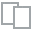
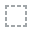
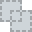
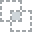
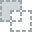
...
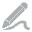
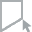
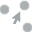
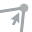
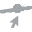

In [18]:
plot(data[continuous])

From the graphs we can see that there are some severe outliers present within the data.

### book_value_per_share

Entry 150

For book_value_per_share we can clearly see that it is an mistake as the asset_total of the credit firm is only 36762.74 which obviously doesnt warrant a 15 million book_value_per_share.

I will just remove this outlier since it is a mistake.

### total_debt/total_assets

Entry 881

The outlier of 502.887 is clear a mistake, if we add the debt_in_Current_Liabilities_Total 175.683 and the Long_Term_Debt_Total 10338.098, we get 10493.781 which is still less than the Asset_Total of 20515.139. 


### total_asset/total_libiilities

Entry 881

The entry again has an outlier at 2918.442, this is certainly a mistake total assets is less than total liabilities.

### EBTI/total_assets

Entry 881 again, there are many outliers in this row so I decide to jus remove it.

In [19]:
data.iloc[879,:]

Assets_Total                             20515.139000
Cash                                       416.711000
Debt_in_Current_Liabilities_Total          175.683000
Long_Term_Debt_Total                     10338.098000
Earnings_Before_Interest                  2069.000000
Gross_Profit_(Loss)                       2415.555000
Liabilities_Total                          448.227000
Retained_Earnings                        11132.809000
Total_debt/total_asset                     502.887000
total_asset/total_libiilities             2918.442000
EBTI/total_asset                         -2775.848000
gross_profit/rev                          1702.786000
EBTI/REV                                     0.503925
Dividends_per_Share_Pay_Date_Calendar        1.842764
Sales/Turnover_(Net)                         0.100852
Stockholders_Equity_Total                    0.263232
Interest_and_Related_Expense_Total           1.215068
Market_Value_Total_Fiscal                 1702.786000
Book_Value_Per_Share        

In [20]:
data = data.drop(879)

In [21]:
data.loc[148,"Book_Value_Per_Share"]

15437843.0

In [22]:
data.at[148,"Book_Value_Per_Share"] = np.nan

### book_value_per_share

Entry 431

Stockholder equity is 528.9 which is way less the book value

Entry 1332

Stockholder equity is 489.8 but book value is 489800

Entry 515

Stockholder equity is 2647.8 but book value is -451900, asset/liabilities is also positive

In [23]:
data.loc[429, "Book_Value_Per_Share"]

528900.0

In [24]:
data.at[429, "Book_Value_Per_Share"] = np.nan

In [25]:
data.loc[513, "Book_Value_Per_Share"]

-451900.0

In [26]:
data.at[513, "Book_Value_Per_Share"] = np.nan

In [27]:
data.loc[1330, "Book_Value_Per_Share"]

489800.0

In [28]:
data.at[1330, "Book_Value_Per_Share"] = np.nan

In [29]:
data["Book_Value_Per_Share"].nlargest(n=5)

479     5744.757091
2144     789.504800
1243     695.803700
342      667.657900
2166     606.300800
Name: Book_Value_Per_Share, dtype: float64

  0%|                                                                                         | 0/2898 [00:00<…


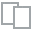
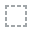
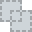
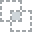
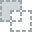
...
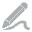
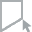
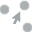
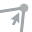
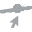

In [30]:
plot(data[continuous])

In [31]:
nulls = data.isnull().sum()
nulls

Assets_Total                             0
Cash                                     0
Debt_in_Current_Liabilities_Total        0
Long_Term_Debt_Total                     0
Earnings_Before_Interest                 0
Gross_Profit_(Loss)                      0
Liabilities_Total                        0
Retained_Earnings                        0
Total_debt/total_asset                   0
total_asset/total_libiilities            0
EBTI/total_asset                         0
gross_profit/rev                         0
EBTI/REV                                 0
Dividends_per_Share_Pay_Date_Calendar    0
Sales/Turnover_(Net)                     0
Stockholders_Equity_Total                0
Interest_and_Related_Expense_Total       0
Market_Value_Total_Fiscal                0
Book_Value_Per_Share                     4
Common_Equity_Liquidation_Value          0
Comprehensive_Income_Parent              0
Employees                                0
Inventories_Total                        0
Earnings_Pe

In [32]:
data.columns

Index(['Assets_Total', 'Cash', 'Debt_in_Current_Liabilities_Total',
       'Long_Term_Debt_Total', 'Earnings_Before_Interest',
       'Gross_Profit_(Loss)', 'Liabilities_Total', 'Retained_Earnings',
       'Total_debt/total_asset', 'total_asset/total_libiilities',
       'EBTI/total_asset', 'gross_profit/rev', 'EBTI/REV',
       'Dividends_per_Share_Pay_Date_Calendar', 'Sales/Turnover_(Net)',
       'Stockholders_Equity_Total', 'Interest_and_Related_Expense_Total',
       'Market_Value_Total_Fiscal', 'Book_Value_Per_Share',
       'Common_Equity_Liquidation_Value', 'Comprehensive_Income_Parent',
       'Employees', 'Inventories_Total', 'Earnings_Per_Share_from_Operations',
       'Revenue_Total', 'Operating_Activities_Net_Cash_Flow',
       'Financing_Activities_Net_Cash_Flow', 'Net_Cash_Flow', 'Rating'],
      dtype='object')

In [33]:
for i in range(len(nulls)):
    if nulls[i] > 0:
        feature_name = data.columns[i]
        most_correlated = data.corr()[feature_name].abs().sort_values(ascending=False).head(3)
        most_correlated = most_correlated.index

        print(feature_name)
        print(most_correlated)
        print()

        predictors = most_correlated
        X_train = data.loc[:,predictors]
        imputer =  IterativeImputer()
        imputer.fit(X_train)
        data[predictors] = imputer.transform(data[predictors])

Book_Value_Per_Share
Index(['Book_Value_Per_Share', 'Earnings_Per_Share_from_Operations',
       'Total_debt/total_asset'],
      dtype='object')



In [34]:
data.at[429, "Book_Value_Per_Share"]

0.31042638724749594

  0%|                                                                                         | 0/2898 [00:00<…


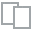
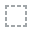
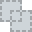
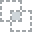
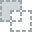
...
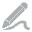
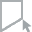
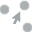
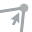
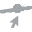

In [35]:
plot(data[continuous])

### Correlation of variables with rating

In [36]:
data.corr()["Rating"].abs().sort_values(ascending=False)

Rating                                   1.000000
Total_debt/total_asset                   0.444435
Market_Value_Total_Fiscal                0.427121
Gross_Profit_(Loss)                      0.379602
Earnings_Before_Interest                 0.366999
Dividends_per_Share_Pay_Date_Calendar    0.366741
Revenue_Total                            0.364881
Sales/Turnover_(Net)                     0.364881
Common_Equity_Liquidation_Value          0.359100
Stockholders_Equity_Total                0.358232
Operating_Activities_Net_Cash_Flow       0.343855
Retained_Earnings                        0.312402
Employees                                0.303464
Earnings_Per_Share_from_Operations       0.299926
Comprehensive_Income_Parent              0.297678
Assets_Total                             0.251007
Long_Term_Debt_Total                     0.235211
Cash                                     0.232749
Liabilities_Total                        0.220490
Interest_and_Related_Expense_Total       0.207116


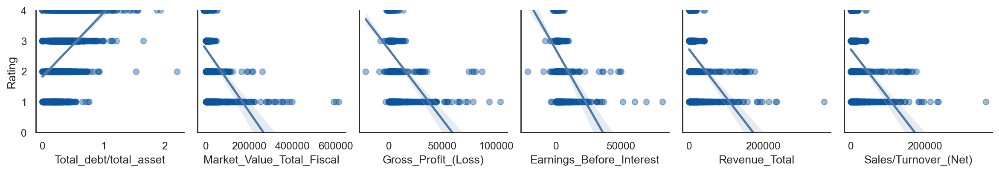

In [37]:
x_vars=["Total_debt/total_asset", "Market_Value_Total_Fiscal", "Gross_Profit_(Loss)", "Earnings_Before_Interest", "Revenue_Total", "Sales/Turnover_(Net)"]
y_vars=["Rating"]
with sns.axes_style('white'):
    g=sns.pairplot(x_vars = x_vars, y_vars=y_vars, data=data, kind='reg', 
                   plot_kws={'scatter_kws' :{'color': sns.color_palette('Blues')[-1], 'alpha': 0.4}})

plt.ylim(0, 4)
plt.show()


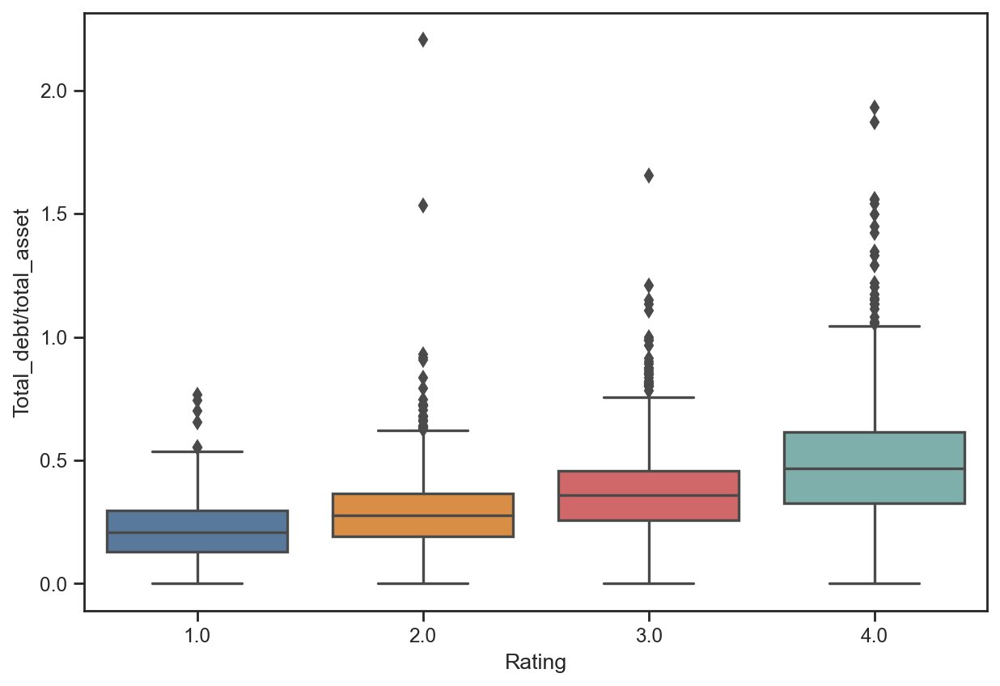

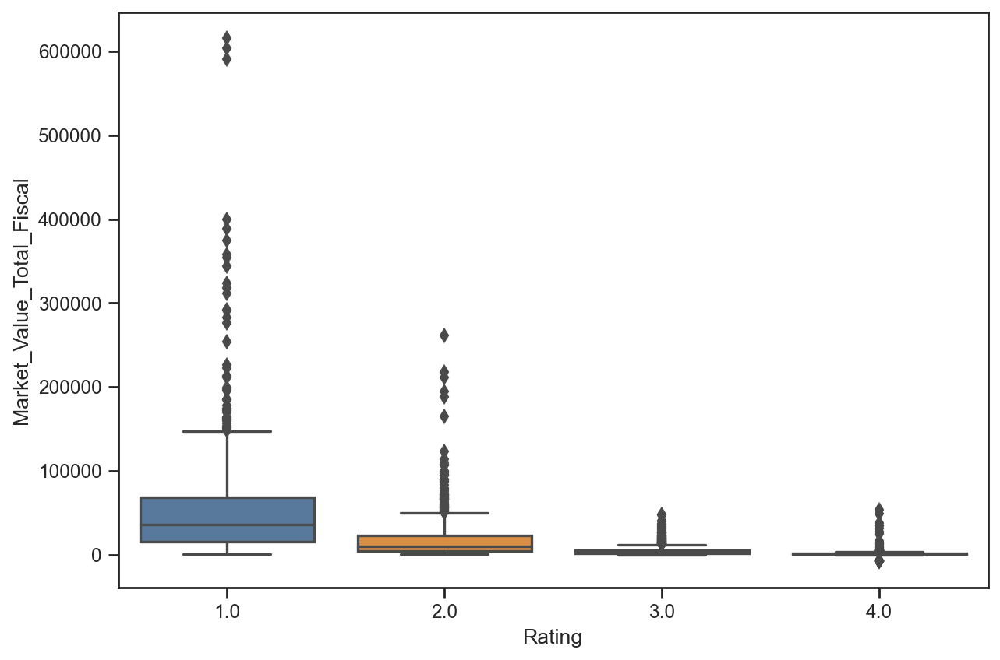

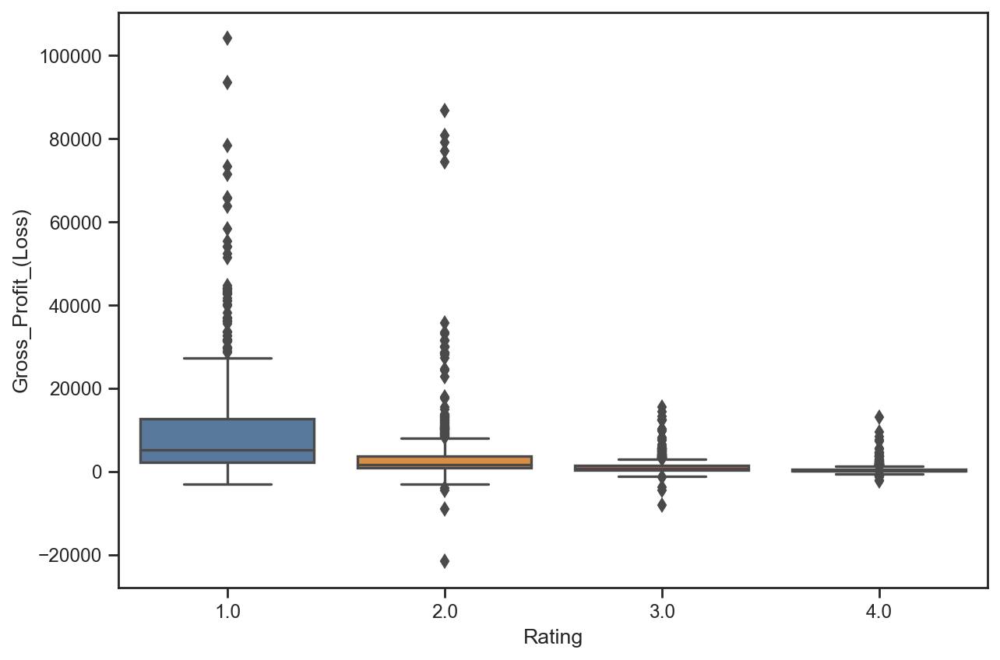

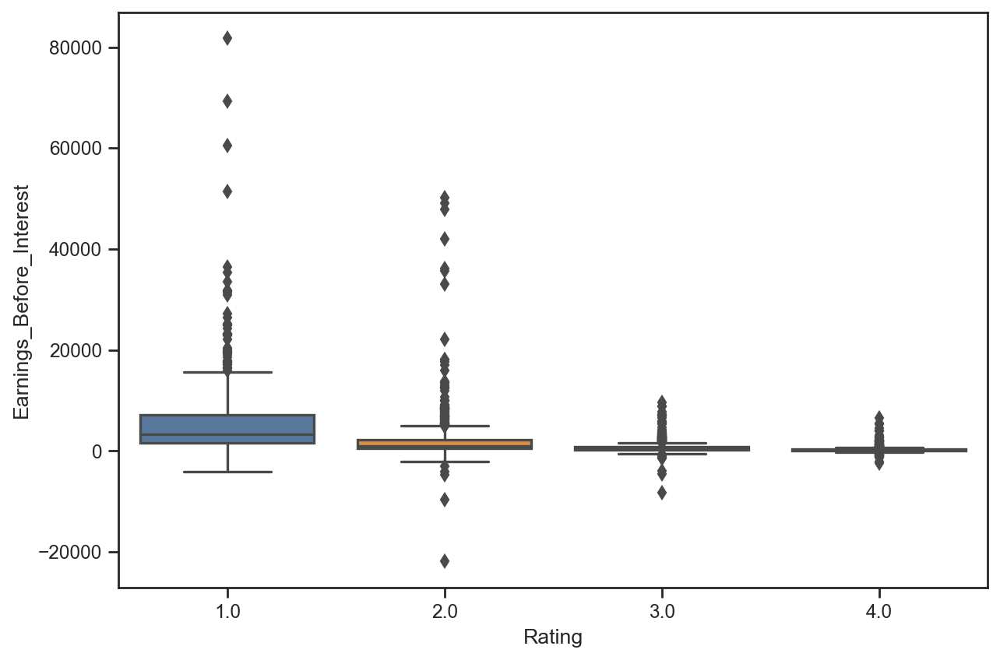

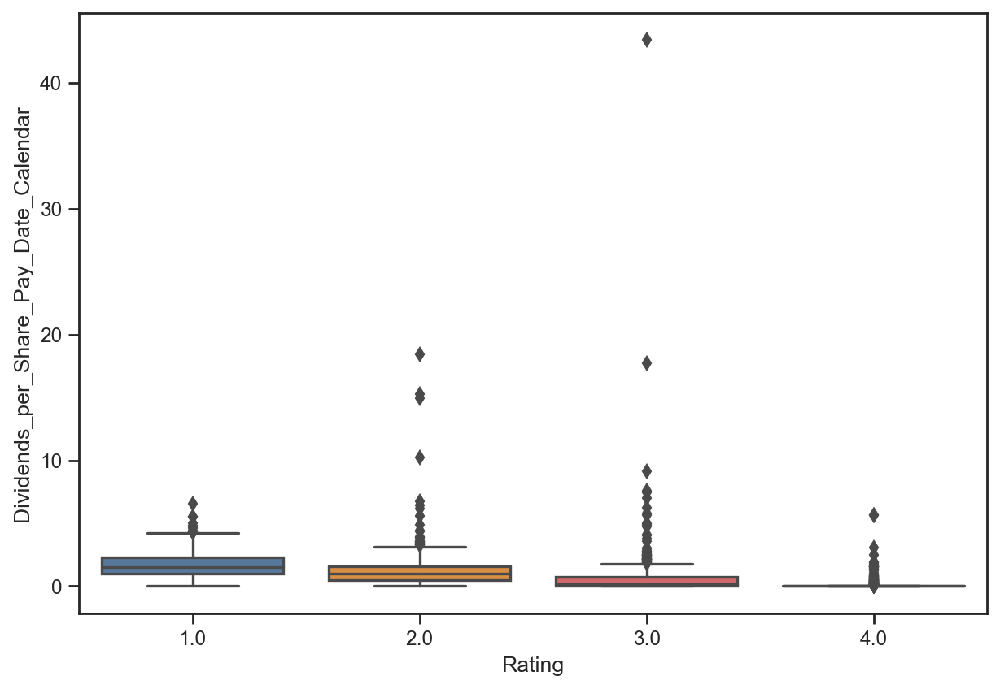

In [38]:
x_vars=["Total_debt/total_asset", "Market_Value_Total_Fiscal", "Gross_Profit_(Loss)", "Earnings_Before_Interest", "Dividends_per_Share_Pay_Date_Calendar"]
y_var="Rating"


for i in x_vars:
    box = sns.boxplot(data=data, x=y_var, y=i)
    plt.show()

<AxesSubplot:title={'center':'Correlation Heatmap'}>

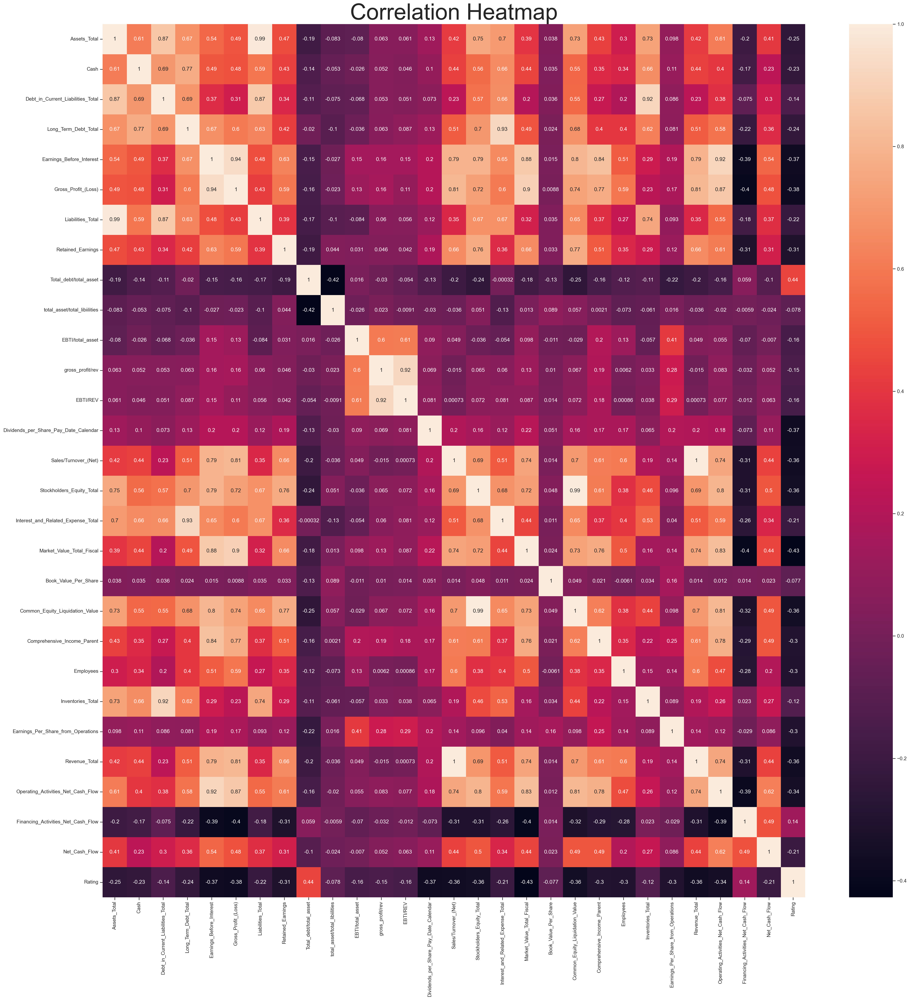

In [39]:
plt.subplots(figsize=(35,35))
plt.title("Correlation Heatmap", fontsize=50)
sns.heatmap(data.corr(), annot=True)


# Variable Selection

In [40]:


# We go through the list of predictors and fit each one, then we compare the accuracy, we add the variable that adds the most
# accuracy to the model, then we remove the variable from the set and repeat the step above until the accuracy no longer 
# improves

def forward_selected(X_train, y_train):
    X_train = X_train.copy()
    
    df = pd.DataFrame(X_train.iloc[:, 0])
    
    X_train = X_train.iloc[: , 1:]

    best_model = LinearRegression().fit(df, y_train)
    y_pred = rounding(best_model.predict(df))
    best_error = mean_absolute_error(y_pred, y_train)
    
    for j in range(len(X_train.columns)):
        
        for i in X_train:
            temp_df = df.copy()
            temp_df[i] = X_train[[i]]
            forward_model = LinearRegression().fit(temp_df, y_train)
            y_pred = rounding(forward_model.predict(temp_df))
            error = mean_absolute_error(y_pred, y_train)
            
            if error < best_error:
                best_model = forward_model
                best_error = error
                print(best_error)
                df = temp_df
                X_train.drop(columns=X_train[[i]], inplace=True)
                break
        
            
    return best_model, df.columns, best_error

# Data splitting

In [41]:
# splitting the data set into testing and training
X = data.loc[:, data.columns!='Rating']
# X = (X-X.min())/(X.max()-X.min())
y = data['Rating']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)

# Linear regression

In [42]:
def rounding(y_pred):
    for k in range(len(y_pred)):
        if y_pred[k] < 1:
            y_pred[k] = 1
            
        elif y_pred[k] > 4:
            y_pred[k] = 4
        else:
            y_pred[k] = round(y_pred[k])
    return y_pred

In [43]:
best_model, predictors, best_error = forward_selected(X_train, y_train)

0.7674033149171271
0.7248618784530386
0.6900552486187845
0.6895027624309392
0.6878453038674033
0.687292817679558
0.6171270718232044
0.6121546961325967
0.6071823204419889
0.587292817679558
0.5861878453038674
0.5298342541436464
0.5276243093922652
0.5243093922651934
0.5077348066298343
0.5060773480662983
0.5038674033149171
0.5033149171270718


In [44]:
predictors

Index(['Assets_Total', 'Cash', 'Debt_in_Current_Liabilities_Total',
       'Earnings_Before_Interest', 'Long_Term_Debt_Total',
       'Gross_Profit_(Loss)', 'Liabilities_Total', 'Total_debt/total_asset',
       'Retained_Earnings', 'total_asset/total_libiilities',
       'EBTI/total_asset', 'gross_profit/rev',
       'Dividends_per_Share_Pay_Date_Calendar', 'EBTI/REV',
       'Interest_and_Related_Expense_Total', 'Market_Value_Total_Fiscal',
       'Stockholders_Equity_Total', 'Comprehensive_Income_Parent',
       'Operating_Activities_Net_Cash_Flow'],
      dtype='object')

<AxesSubplot:title={'center':'Correlation Heatmap'}>

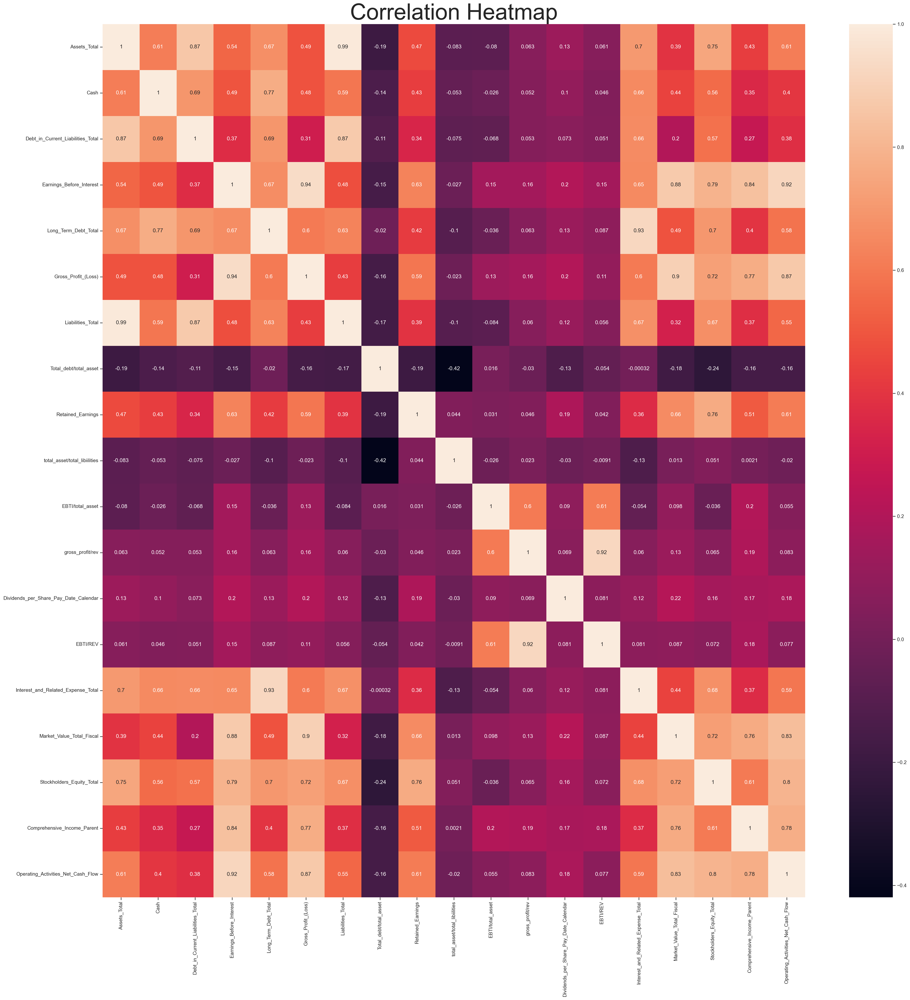

In [45]:
plt.subplots(figsize=(35,35))
plt.title("Correlation Heatmap", fontsize=50)
sns.heatmap(data[predictors].corr(), annot=True)


In [46]:
reg = LinearRegression().fit(X_train, y_train)
y_pred = reg.predict(X_test)
mean_absolute_error(y_test, rounding(y_pred))

0.5089686098654709

In [47]:
reg = LinearRegression().fit(X_train[predictors], y_train)
y_pred = reg.predict(X_test[predictors])
mean_absolute_error(y_test, rounding(y_pred))

0.5033632286995515

Text(0.5, 1.0, 'Prediction VS Residual plot')

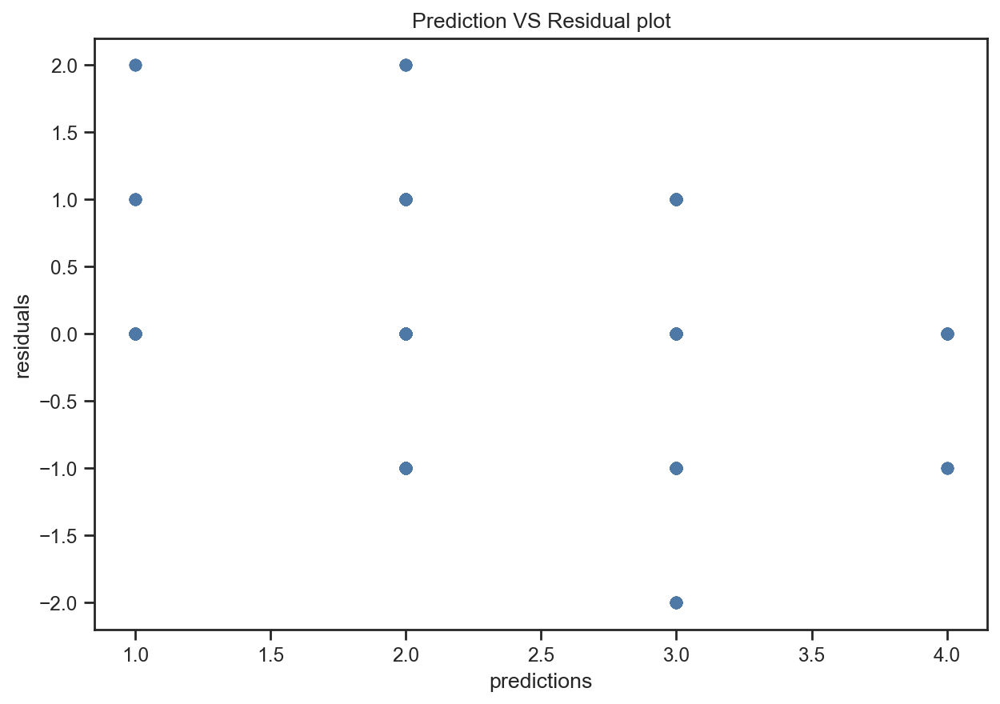

In [48]:
plt.scatter(rounding(y_pred), y_test - rounding(y_pred))
plt.xlabel("predictions")
plt.ylabel("residuals")
plt.title("Prediction VS Residual plot")

# KNN regression

In [49]:
def forward_selected_KNN(X_train, y_train):
    X_train = X_train.copy()
    
    df = pd.DataFrame(X_train.iloc[:, 0])
    
    X_train = X_train.iloc[: , 1:]

    best_model = LinearRegression().fit(df, y_train)
    y_pred = rounding(best_model.predict(df))
    best_error = mean_absolute_error(y_pred, y_train)
    
    for j in range(len(X_train.columns)):
        
        for i in X_train:
            temp_df = df.copy()
            temp_df[i] = X_train[[i]]
            forward_model = LinearRegression().fit(temp_df, y_train)
            y_pred = rounding(forward_model.predict(temp_df))
            error = mean_absolute_error(y_pred, y_train)
            
            if error < best_error:
                best_model = forward_model
                best_error = error
                print(best_error)
                df = temp_df
                X_train.drop(columns=X_train[[i]], inplace=True)
                break
        
            
    return best_model, df.columns, best_error

In [50]:
# cv to choose number of neighbours

def knn_test(predictors, response, best_score):
    best_knn = 0
    neighbours=np.arange(1, 20)
    best_neighbours = 0
    
    for k in neighbours: 
        knn = KNeighborsRegressor(n_neighbors = k, metric='mahalanobis', metric_params={'VI': X_train[predictors].cov()}) 
        scores = cross_val_score(knn, X_train[predictors], y_train, cv=10, scoring = 'neg_mean_absolute_error')
        # taking the average of scores across 10 folds
        cv_score = np.mean(scores)
        # use the cv score for model selection
        if cv_score > best_score:
            print(cv_score)
            best_neighbours = k
            best_score = cv_score
            best_knn = knn
    
    return best_score, best_neighbours

In [51]:
print(len(X_train.columns))

28


In [52]:
def forward_KNN_selection(X_train, y_train):
    X_train = X_train.copy()
    y_train = y_train.copy()
    
    best_score = -np.inf
    best_neighbor = 0
    
    full_predictors = X_train.columns.tolist()
    print(len(full_predictors))
    predictors = []
    
    j = 0
    while j < len(full_predictors):
        added = 0
        print(j)
        for i in range(len(full_predictors)):
            print(full_predictors[i])
            print(predictors)
            temp = predictors + [full_predictors[i]]
            
            score, k = knn_test(temp, "rating", best_score)
            
            if score > best_score:
                added = 1
                best_score = score
                best_neighbor = k
                predictors.append(full_predictors[i])
                full_predictors.pop(i)
                break
        if added == 0:
            break
        j += 1
                
    return best_score, predictors, best_neighbor

In [53]:
score, predictor, k = forward_KNN_selection(X_train, y_train)

28
0
Assets_Total
[]
-0.7994475138121546
-0.737292817679558
-0.7090239410681399
-0.6922651933701658
-0.6830939226519337
-0.6786372007366481
-0.6687450670876085
-0.6617403314917126
-0.6575199508901167
-0.6548618784530387
-0.6510296333500754
-0.6507862303442413
-0.6504604051565377
-0.6502762430939226
-0.6472863178420539
1
Cash
['Assets_Total']
Debt_in_Current_Liabilities_Total
['Assets_Total']
-0.647108655616943
-0.6469904041872638
2
Cash
['Assets_Total', 'Debt_in_Current_Liabilities_Total']
Long_Term_Debt_Total
['Assets_Total', 'Debt_in_Current_Liabilities_Total']
-0.630939226519337
-0.6258287292817679
-0.6230939226519338
-0.620902394106814
-0.6134964483030781
-0.6090469613259669
3
Cash
['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total']
Earnings_Before_Interest
['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total']
Gross_Profit_(Loss)
['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total']
-0.6081767955801105
-0.604

EBTI/REV
['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total', 'Gross_Profit_(Loss)', 'Cash', 'Earnings_Before_Interest', 'Retained_Earnings', 'Sales/Turnover_(Net)', 'Stockholders_Equity_Total', 'Market_Value_Total_Fiscal']
Dividends_per_Share_Pay_Date_Calendar
['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total', 'Gross_Profit_(Loss)', 'Cash', 'Earnings_Before_Interest', 'Retained_Earnings', 'Sales/Turnover_(Net)', 'Stockholders_Equity_Total', 'Market_Value_Total_Fiscal']
Interest_and_Related_Expense_Total
['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total', 'Gross_Profit_(Loss)', 'Cash', 'Earnings_Before_Interest', 'Retained_Earnings', 'Sales/Turnover_(Net)', 'Stockholders_Equity_Total', 'Market_Value_Total_Fiscal']
Book_Value_Per_Share
['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total', 'Gross_Profit_(Loss)', 'Cash', 'Earnings_Before_Interest', 'Retained_Earnings', 'Sales/Turnover_(Ne

13
Liabilities_Total
['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total', 'Gross_Profit_(Loss)', 'Cash', 'Earnings_Before_Interest', 'Retained_Earnings', 'Sales/Turnover_(Net)', 'Stockholders_Equity_Total', 'Market_Value_Total_Fiscal', 'Inventories_Total', 'Common_Equity_Liquidation_Value', 'Comprehensive_Income_Parent']
Total_debt/total_asset
['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total', 'Gross_Profit_(Loss)', 'Cash', 'Earnings_Before_Interest', 'Retained_Earnings', 'Sales/Turnover_(Net)', 'Stockholders_Equity_Total', 'Market_Value_Total_Fiscal', 'Inventories_Total', 'Common_Equity_Liquidation_Value', 'Comprehensive_Income_Parent']
total_asset/total_libiilities
['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total', 'Gross_Profit_(Loss)', 'Cash', 'Earnings_Before_Interest', 'Retained_Earnings', 'Sales/Turnover_(Net)', 'Stockholders_Equity_Total', 'Market_Value_Total_Fiscal', 'Inventories_Total', 'Common_Equ

In [54]:
predictors = ['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total', 'Gross_Profit_(Loss)', 'Cash', 'Earnings_Before_Interest', 'Retained_Earnings', 'Sales/Turnover_(Net)', 'Stockholders_Equity_Total']
print(score)
print(len(predictor))
print(k)

-0.4585635359116022
14
1


In [55]:
knn_model = KNeighborsRegressor(n_neighbors=k).fit(X_train[predictor], y_train)

print(knn_model.score(X_test[predictor], y_test))

y_pred = knn_model.predict(X_test[predictor])

print(mean_absolute_error(y_pred, y_test))

0.6756363636363636
0.2556053811659193


# Random Forest

In [56]:
from sklearn.ensemble import RandomForestClassifier

In [57]:
clf = RandomForestClassifier(n_estimators=200, n_jobs=3, random_state=1)
clf = clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
mean_absolute_error(y_pred, y_test)

0.20515695067264575

In [58]:
n = 500

mae = []

best_estimators = 0
best_score = -np.inf

for i in range(1,n):
    clf = RandomForestClassifier(n_estimators=i, random_state=1, n_jobs=5)
    scores = cross_val_score(clf, X_train[predictors], y_train, cv=5, scoring = 'neg_mean_absolute_error')
    # taking the average of scores acchross 10 folds
    cv_score = np.mean(scores)
    print(cv_score)
    # use the cv score for model selection
    if cv_score >= best_score:
        best_estimators = i
        best_score = cv_score
        print(best_score)

-0.4917127071823204
-0.4917127071823204
-0.4966850828729282
-0.46850828729281774
-0.46850828729281774
-0.39723756906077345
-0.39723756906077345
-0.3751381215469613
-0.3751381215469613
-0.3795580110497238
-0.35303867403314915
-0.35303867403314915
-0.343646408839779
-0.343646408839779
-0.33480662983425413
-0.33480662983425413
-0.3292817679558011
-0.3292817679558011
-0.33038674033149174
-0.3220994475138122
-0.3220994475138122
-0.3259668508287293
-0.3237569060773481
-0.32320441988950277
-0.32044198895027626
-0.32044198895027626
-0.32044198895027626
-0.32044198895027626
-0.31988950276243094
-0.31988950276243094
-0.32320441988950277
-0.3154696132596685
-0.3154696132596685
-0.3138121546961326
-0.3138121546961326
-0.3088397790055249
-0.3088397790055249
-0.30939226519337015
-0.30773480662983427
-0.30773480662983427
-0.3060773480662983
-0.3060773480662983
-0.30718232044198895
-0.30773480662983427
-0.30773480662983427
-0.3038674033149171
-0.3038674033149171
-0.3138121546961326
-0.3099447513812155

-0.2878453038674033
-0.2883977900552487
-0.28674033149171274
-0.2878453038674033
-0.2900552486187845
-0.28950276243093925
-0.2878453038674033
-0.2878453038674033
-0.2883977900552486
-0.28895027624309394
-0.2883977900552486
-0.28784530386740337
-0.28895027624309394
-0.28895027624309394
-0.28895027624309394
-0.28895027624309394
-0.28895027624309394
-0.2883977900552486
-0.28895027624309394
-0.2878453038674033
-0.2895027624309392
-0.2883977900552486
-0.2895027624309392
-0.2883977900552486
-0.28895027624309394
-0.28674033149171274
-0.28729281767955805
-0.28729281767955805
-0.28784530386740337
-0.28784530386740337
-0.28950276243093925
-0.2895027624309393
-0.28895027624309394
-0.2883977900552487
-0.2883977900552486
-0.2883977900552487
-0.28895027624309394
-0.2883977900552486
-0.28895027624309394
-0.287292817679558
-0.2883977900552487
-0.2878453038674033
-0.287292817679558
-0.28674033149171274
-0.2861878453038674
-0.28674033149171274
-0.2861878453038674
-0.287292817679558
-0.28674033149171274


In [59]:
print(best_estimators)


483


In [60]:
clf = RandomForestClassifier(n_estimators=best_estimators, random_state=1, n_jobs=5)
clf = clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
mean_absolute_error(y_pred, y_test)

0.19282511210762332

In [61]:

importances = clf.feature_importances_
std = np.std([tree.feature_importances_ for tree in clf.estimators_], axis=0)


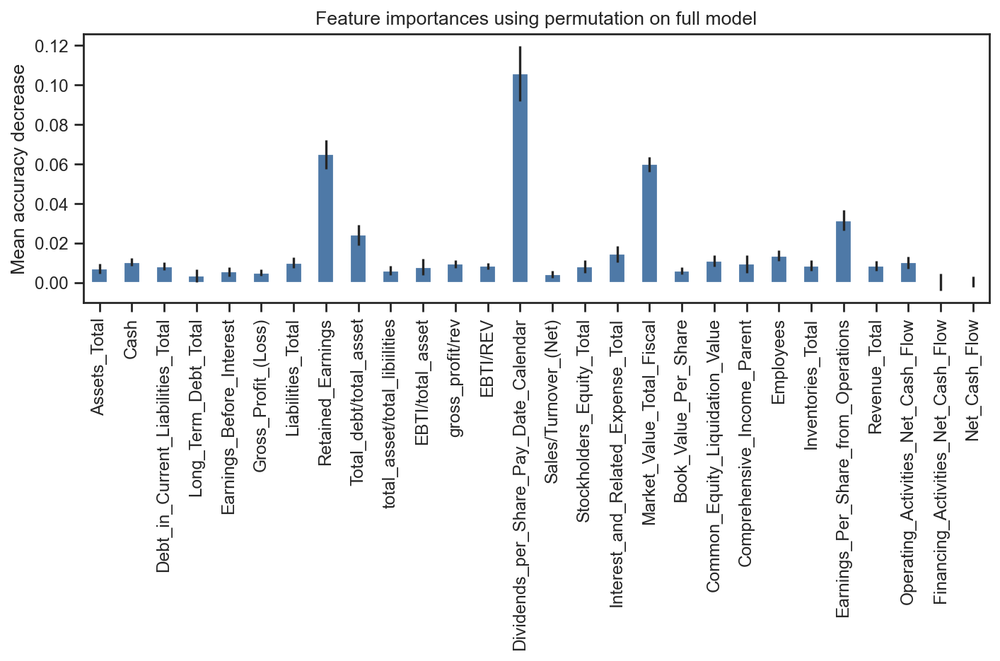

In [62]:
#taken from sklearn
from sklearn.inspection import permutation_importance

result = permutation_importance(
    clf, X_test, y_test, n_repeats=10, random_state=1, n_jobs=2
)
forest_importances = pd.Series(result.importances_mean, index=X_train.columns)

fig, ax = plt.subplots()
forest_importances.plot.bar(yerr=result.importances_std, ax=ax)
ax.set_title("Feature importances using permutation on full model")
ax.set_ylabel("Mean accuracy decrease")
fig.tight_layout()
plt.show()

In [63]:
X_train.loc[:, 'Dividends_per_Share_Pay_Date_Calendar']

447     0.0000
2157    0.9300
2457    0.5397
364     0.0000
1013    1.8850
         ...  
961     2.9400
906     3.2000
1097    0.2500
235     2.7100
1062    1.0000
Name: Dividends_per_Share_Pay_Date_Calendar, Length: 1810, dtype: float64

In [64]:
y_train.shape

(1810,)

# Best single predictor

In [65]:
clf = RandomForestClassifier(n_estimators=best_estimators, random_state=1, n_jobs=5)
clf = clf.fit(X_train[['Dividends_per_Share_Pay_Date_Calendar']], y_train)
y_pred = clf.predict(X_test[['Dividends_per_Share_Pay_Date_Calendar']])
mae = mean_absolute_error(y_pred, y_test)
mae

0.6860986547085202

In [66]:
best = -np.inf
best_predictor = ""

pred_dic = {"pred_lin": "", "pred_rf": "", "pred_knn": ""}
mae_dic = {"mae_rf": -np.inf, "mae_lin": -np.inf, "mae_knn": -np.inf}

for i in X_train.columns:
    print(i)
    clf = RandomForestClassifier(n_estimators=best_estimators, random_state=1, n_jobs=5)
    clf = clf.fit(X_train[[i]], y_train)
    rf_scores = cross_val_score(clf, X_train[[i]], y_train, cv=10, scoring = 'neg_mean_absolute_error')
    score_rf = np.mean(rf_scores)
    
    reg = LinearRegression().fit(X_train[[i]], y_train)
    lin_scores = cross_val_score(reg, X_train[[i]], y_train, cv=10, scoring = 'neg_mean_absolute_error')
    score_lin = np.mean(lin_scores)
    
    knn_model = KNeighborsRegressor(n_neighbors=k).fit(X_train[[i]], y_train)
    knn_scores = cross_val_score(knn_model, X_train[[i]], y_train, cv=10, scoring = 'neg_mean_absolute_error')
    score_knn = np.mean(knn_scores)
    
    if score_rf > mae_dic["mae_rf"]:
        pred_dic["pred_rf"] = i
        mae_dic["mae_rf"] = score_rf
    
    if score_lin > mae_dic["mae_lin"]:
        pred_dic["pred_lin"] = i
        mae_dic["mae_lin"] = score_lin
        
    if score_knn > mae_dic["mae_knn"]:
        pred_dic["pred_knn"] = i
        mae_dic["mae_knn"] = score_knn


Assets_Total
Cash
Debt_in_Current_Liabilities_Total
Long_Term_Debt_Total
Earnings_Before_Interest
Gross_Profit_(Loss)
Liabilities_Total
Retained_Earnings
Total_debt/total_asset
total_asset/total_libiilities
EBTI/total_asset
gross_profit/rev
EBTI/REV
Dividends_per_Share_Pay_Date_Calendar
Sales/Turnover_(Net)
Stockholders_Equity_Total
Interest_and_Related_Expense_Total
Market_Value_Total_Fiscal
Book_Value_Per_Share
Common_Equity_Liquidation_Value
Comprehensive_Income_Parent
Employees
Inventories_Total
Earnings_Per_Share_from_Operations
Revenue_Total
Operating_Activities_Net_Cash_Flow
Financing_Activities_Net_Cash_Flow
Net_Cash_Flow


In [67]:
print(pred_dic)
print(mae_dic)

{'pred_lin': 'Dividends_per_Share_Pay_Date_Calendar', 'pred_rf': 'Market_Value_Total_Fiscal', 'pred_knn': 'Market_Value_Total_Fiscal'}
{'mae_rf': -0.6475138121546962, 'mae_lin': -0.7228103728273816, 'mae_knn': -0.6508287292817679}


In [68]:
n = 500

mae = []

best_estimators = 0
best_score = -np.inf

for i in range(1,n):
    clf = RandomForestClassifier(n_estimators=i, random_state=1, n_jobs=5)
    scores = cross_val_score(clf, X_train[['Market_Value_Total_Fiscal']], y_train, cv=5, scoring = 'neg_mean_absolute_error')
    # taking the average of scores acchross 10 folds
    cv_score = np.mean(scores)
    print(cv_score)
    # use the cv score for model selection
    if cv_score >= best_score:
        best_estimators = i
        best_score = cv_score
        print(best_score)

-0.6425414364640883
-0.6425414364640883
-0.6441988950276244
-0.6414364640883978
-0.6414364640883978
-0.6436464088397791
-0.6359116022099448
-0.6359116022099448
-0.6386740331491711
-0.6364640883977901
-0.6314917127071823
-0.6314917127071823
-0.6337016574585637
-0.6359116022099448
-0.6342541436464088
-0.6397790055248619
-0.6403314917127071
-0.6386740331491713
-0.6408839779005524
-0.6408839779005524
-0.6475138121546962
-0.6464088397790055
-0.6497237569060773
-0.6513812154696133
-0.6491712707182321
-0.6541436464088399
-0.6480662983425415
-0.6475138121546962
-0.6441988950276244
-0.6441988950276244
-0.6469613259668507
-0.6475138121546962
-0.6458563535911603
-0.6458563535911602
-0.6441988950276244
-0.6447513812154696
-0.6430939226519337
-0.6436464088397791
-0.6441988950276244
-0.6453038674033149
-0.6453038674033149
-0.6464088397790055
-0.6475138121546962
-0.6480662983425415
-0.6475138121546962
-0.6480662983425415
-0.649171270718232
-0.6502762430939226
-0.6508287292817679
-0.649171270718232
-0

-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945
-0.6535911602209945


In [69]:
best_estimators

8

In [70]:
clf = RandomForestClassifier(n_estimators=8, random_state=1, n_jobs=5)
clf = clf.fit(X_train[['Market_Value_Total_Fiscal']], y_train)
y_pred = clf.predict(X_test[['Market_Value_Total_Fiscal']])
mean_absolute_error(y_pred, y_test)

0.672645739910314

In [71]:

score, k = knn_test(['Market_Value_Total_Fiscal'], "rating", best_score)


-0.6066298342541436
-0.5764272559852671
-0.5701657458563536
-0.5588950276243094
-0.5485267034990792
-0.5402525651144436
-0.5386740331491713
-0.5356660527931247
-0.5340883977900553
-0.5268709191361125
-0.5241252302025782
-0.5232044198895027
-0.5231719207019825
-0.5226519337016574
-0.5225937772608317


In [72]:
print(k)

19


In [73]:
knn_model = KNeighborsRegressor(n_neighbors=19).fit(X_train[['Market_Value_Total_Fiscal']], y_train)
y_pred = knn_model.predict(X_test[['Market_Value_Total_Fiscal']])
mean_absolute_error(y_pred, y_test)

0.531036110455511

In [74]:
reg = LinearRegression().fit(X_train[['Dividends_per_Share_Pay_Date_Calendar']], y_train)
y_pred = reg.predict(X_test[['Dividends_per_Share_Pay_Date_Calendar']])
mean_absolute_error(y_pred, y_test)

0.7350692254363667

# MPE error calculations

In [75]:
def mpe(true, pred):
    total = 0
    for i in range(len(true)):
        total += (true[i] - pred[i]) / true[i]
    result = 100.0/len(true) * total
    return result

In [76]:
reg = LinearRegression().fit(X_train[['Assets_Total', 'Cash', 'Debt_in_Current_Liabilities_Total',
       'Earnings_Before_Interest', 'Long_Term_Debt_Total',
       'Gross_Profit_(Loss)', 'Liabilities_Total', 'Total_debt/total_asset',
       'Retained_Earnings', 'total_asset/total_libiilities',
       'EBTI/total_asset', 'gross_profit/rev',
       'Dividends_per_Share_Pay_Date_Calendar', 'EBTI/REV',
       'Interest_and_Related_Expense_Total', 'Market_Value_Total_Fiscal',
       'Stockholders_Equity_Total', 'Comprehensive_Income_Parent',
       'Operating_Activities_Net_Cash_Flow']], y_train)
y_pred = reg.predict(X_test[['Assets_Total', 'Cash', 'Debt_in_Current_Liabilities_Total',
       'Earnings_Before_Interest', 'Long_Term_Debt_Total',
       'Gross_Profit_(Loss)', 'Liabilities_Total', 'Total_debt/total_asset',
       'Retained_Earnings', 'total_asset/total_libiilities',
       'EBTI/total_asset', 'gross_profit/rev',
       'Dividends_per_Share_Pay_Date_Calendar', 'EBTI/REV',
       'Interest_and_Related_Expense_Total', 'Market_Value_Total_Fiscal',
       'Stockholders_Equity_Total', 'Comprehensive_Income_Parent',
       'Operating_Activities_Net_Cash_Flow']])
mpe(y_test.tolist(), y_pred.tolist())

-9.652582012591152

In [77]:
knn_model = KNeighborsRegressor(n_neighbors=1).fit(X_train[['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total', 'Gross_Profit_(Loss)', 'Cash', 'Earnings_Before_Interest', 'Retained_Earnings', 'Sales/Turnover_(Net)', 'Stockholders_Equity_Total', 'Market_Value_Total_Fiscal', 'Inventories_Total', 'Common_Equity_Liquidation_Value', 'Comprehensive_Income_Parent']], y_train)
y_pred = knn_model.predict(X_test[['Assets_Total', 'Debt_in_Current_Liabilities_Total', 'Long_Term_Debt_Total', 'Gross_Profit_(Loss)', 'Cash', 'Earnings_Before_Interest', 'Retained_Earnings', 'Sales/Turnover_(Net)', 'Stockholders_Equity_Total', 'Market_Value_Total_Fiscal', 'Inventories_Total', 'Common_Equity_Liquidation_Value', 'Comprehensive_Income_Parent']])
mpe(y_test.tolist(), y_pred.tolist())

-3.4846786248131547

In [78]:
clf = RandomForestClassifier(n_estimators=483, random_state=1, n_jobs=5)
clf = clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
mpe(y_test.tolist(), y_pred.tolist())

-4.46562032884903